Problem Statement-Every year a lot of companies hire a number of employees. The companies invest time and money in training those employees, not just this but there are training programs within the companies for their existing employees as well. The aim of these programs is to increase the effectiveness of their employees. But where HR Analytics fit in this? and is it just about improving the performance of employees?

In [69]:
import numpy as np                               #imported library
import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.ensemble import GradientBoostingClassifier, AdaBoostClassifier, BaggingClassifier, RandomForestClassifier, ExtraTreesClassifier
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
import warnings
import pickle
warnings.filterwarnings('ignore')

In [70]:
csv_file_path = '/Users/ashwanisindhu/Downloads/WA_Fn-UseC_-HR-Employee-Attrition.csv'
HR_df= pd.read_csv(csv_file_path)

In [71]:
HR_df                         #loading the dataset

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,...,1,80,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,...,4,80,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,2,80,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,...,3,80,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,...,4,80,1,6,3,3,2,2,2,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1465,36,No,Travel_Frequently,884,Research & Development,23,2,Medical,1,2061,...,3,80,1,17,3,3,5,2,0,3
1466,39,No,Travel_Rarely,613,Research & Development,6,1,Medical,1,2062,...,1,80,1,9,5,3,7,7,1,7
1467,27,No,Travel_Rarely,155,Research & Development,4,3,Life Sciences,1,2064,...,2,80,1,6,0,3,6,2,0,3
1468,49,No,Travel_Frequently,1023,Sales,2,3,Medical,1,2065,...,4,80,0,17,3,2,9,6,0,8


In [72]:
HR_df.head()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,...,1,80,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,...,4,80,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,2,80,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,...,3,80,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,...,4,80,1,6,3,3,2,2,2,2


In [73]:
HR_df.tail()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
1465,36,No,Travel_Frequently,884,Research & Development,23,2,Medical,1,2061,...,3,80,1,17,3,3,5,2,0,3
1466,39,No,Travel_Rarely,613,Research & Development,6,1,Medical,1,2062,...,1,80,1,9,5,3,7,7,1,7
1467,27,No,Travel_Rarely,155,Research & Development,4,3,Life Sciences,1,2064,...,2,80,1,6,0,3,6,2,0,3
1468,49,No,Travel_Frequently,1023,Sales,2,3,Medical,1,2065,...,4,80,0,17,3,2,9,6,0,8
1469,34,No,Travel_Rarely,628,Research & Development,8,3,Medical,1,2068,...,1,80,0,6,3,4,4,3,1,2


# Data Exploration

In [74]:
HR_df.shape

(1470, 35)

In [75]:
HR_df.columns              # #Checking the different columns present.

Index(['Age', 'Attrition', 'BusinessTravel', 'DailyRate', 'Department',
       'DistanceFromHome', 'Education', 'EducationField', 'EmployeeCount',
       'EmployeeNumber', 'EnvironmentSatisfaction', 'Gender', 'HourlyRate',
       'JobInvolvement', 'JobLevel', 'JobRole', 'JobSatisfaction',
       'MaritalStatus', 'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked',
       'Over18', 'OverTime', 'PercentSalaryHike', 'PerformanceRating',
       'RelationshipSatisfaction', 'StandardHours', 'StockOptionLevel',
       'TotalWorkingYears', 'TrainingTimesLastYear', 'WorkLifeBalance',
       'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion',
       'YearsWithCurrManager'],
      dtype='object')

In [76]:
HR_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1470 entries, 0 to 1469
Data columns (total 35 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   Age                       1470 non-null   int64 
 1   Attrition                 1470 non-null   object
 2   BusinessTravel            1470 non-null   object
 3   DailyRate                 1470 non-null   int64 
 4   Department                1470 non-null   object
 5   DistanceFromHome          1470 non-null   int64 
 6   Education                 1470 non-null   int64 
 7   EducationField            1470 non-null   object
 8   EmployeeCount             1470 non-null   int64 
 9   EmployeeNumber            1470 non-null   int64 
 10  EnvironmentSatisfaction   1470 non-null   int64 
 11  Gender                    1470 non-null   object
 12  HourlyRate                1470 non-null   int64 
 13  JobInvolvement            1470 non-null   int64 
 14  JobLevel                

With the help of above function we can get the detailed information about the data like Range index,Colunm name, non-null count, data type and memory usage.

In [77]:
HR_df.dtypes

Age                          int64
Attrition                   object
BusinessTravel              object
DailyRate                    int64
Department                  object
DistanceFromHome             int64
Education                    int64
EducationField              object
EmployeeCount                int64
EmployeeNumber               int64
EnvironmentSatisfaction      int64
Gender                      object
HourlyRate                   int64
JobInvolvement               int64
JobLevel                     int64
JobRole                     object
JobSatisfaction              int64
MaritalStatus               object
MonthlyIncome                int64
MonthlyRate                  int64
NumCompaniesWorked           int64
Over18                      object
OverTime                    object
PercentSalaryHike            int64
PerformanceRating            int64
RelationshipSatisfaction     int64
StandardHours                int64
StockOptionLevel             int64
TotalWorkingYears   

It is observed that both numerical and categroical data is present in th dataset.

In [78]:
HR_df.isnull().sum()               #There is no null value present in the dataset

Age                         0
Attrition                   0
BusinessTravel              0
DailyRate                   0
Department                  0
DistanceFromHome            0
Education                   0
EducationField              0
EmployeeCount               0
EmployeeNumber              0
EnvironmentSatisfaction     0
Gender                      0
HourlyRate                  0
JobInvolvement              0
JobLevel                    0
JobRole                     0
JobSatisfaction             0
MaritalStatus               0
MonthlyIncome               0
MonthlyRate                 0
NumCompaniesWorked          0
Over18                      0
OverTime                    0
PercentSalaryHike           0
PerformanceRating           0
RelationshipSatisfaction    0
StandardHours               0
StockOptionLevel            0
TotalWorkingYears           0
TrainingTimesLastYear       0
WorkLifeBalance             0
YearsAtCompany              0
YearsInCurrentRole          0
YearsSince

<Axes: >

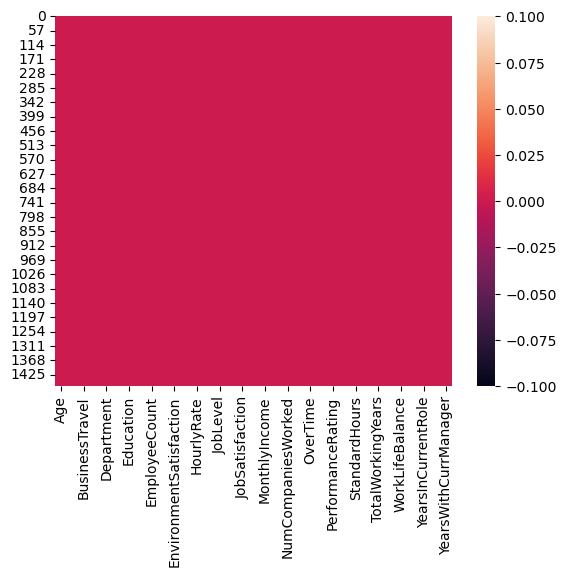

In [79]:
sns.heatmap(HR_df.isnull())

In [80]:
HR_df.Attrition.unique()

array(['Yes', 'No'], dtype=object)

In [81]:
HR_df.BusinessTravel.unique()

array(['Travel_Rarely', 'Travel_Frequently', 'Non-Travel'], dtype=object)

In [82]:
HR_df.Department.unique()

array(['Sales', 'Research & Development', 'Human Resources'], dtype=object)

In [83]:
HR_df.EducationField.unique()

array(['Life Sciences', 'Other', 'Medical', 'Marketing',
       'Technical Degree', 'Human Resources'], dtype=object)

In [84]:
HR_df.Gender.unique()

array(['Female', 'Male'], dtype=object)

In [85]:
HR_df.JobRole.unique()

array(['Sales Executive', 'Research Scientist', 'Laboratory Technician',
       'Manufacturing Director', 'Healthcare Representative', 'Manager',
       'Sales Representative', 'Research Director', 'Human Resources'],
      dtype=object)

In [86]:
HR_df.Over18.unique()

array(['Y'], dtype=object)

In [87]:
HR_df.OverTime.unique()

array(['Yes', 'No'], dtype=object)

Converting the categroical data into numerical data using label encoder

In [88]:
label_encoders = {}
for column in HR_df.select_dtypes(include=['object']).columns:
        label_encoders[column] = LabelEncoder()
        HR_df[column] = label_encoders[column].fit_transform(HR_df[column])

In [89]:
 HR_df

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,1,2,1102,2,1,2,1,1,1,...,1,80,0,8,0,1,6,4,0,5
1,49,0,1,279,1,8,1,1,1,2,...,4,80,1,10,3,3,10,7,1,7
2,37,1,2,1373,1,2,2,4,1,4,...,2,80,0,7,3,3,0,0,0,0
3,33,0,1,1392,1,3,4,1,1,5,...,3,80,0,8,3,3,8,7,3,0
4,27,0,2,591,1,2,1,3,1,7,...,4,80,1,6,3,3,2,2,2,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1465,36,0,1,884,1,23,2,3,1,2061,...,3,80,1,17,3,3,5,2,0,3
1466,39,0,2,613,1,6,1,3,1,2062,...,1,80,1,9,5,3,7,7,1,7
1467,27,0,2,155,1,4,3,1,1,2064,...,2,80,1,6,0,3,6,2,0,3
1468,49,0,1,1023,2,2,3,3,1,2065,...,4,80,0,17,3,2,9,6,0,8


In [90]:
HR_df.dtypes

Age                         int64
Attrition                   int64
BusinessTravel              int64
DailyRate                   int64
Department                  int64
DistanceFromHome            int64
Education                   int64
EducationField              int64
EmployeeCount               int64
EmployeeNumber              int64
EnvironmentSatisfaction     int64
Gender                      int64
HourlyRate                  int64
JobInvolvement              int64
JobLevel                    int64
JobRole                     int64
JobSatisfaction             int64
MaritalStatus               int64
MonthlyIncome               int64
MonthlyRate                 int64
NumCompaniesWorked          int64
Over18                      int64
OverTime                    int64
PercentSalaryHike           int64
PerformanceRating           int64
RelationshipSatisfaction    int64
StandardHours               int64
StockOptionLevel            int64
TotalWorkingYears           int64
TrainingTimesL

In [91]:
 HR_df.describe()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
count,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.0,1470.000000,...,1470.000000,1470.0,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000
mean,36.923810,0.161224,1.607483,802.485714,1.260544,9.192517,2.912925,2.247619,1.0,1024.865306,...,2.712245,80.0,0.793878,11.279592,2.799320,2.761224,7.008163,4.229252,2.187755,4.123129
std,9.135373,0.367863,0.665455,403.509100,0.527792,8.106864,1.024165,1.331369,0.0,602.024335,...,1.081209,0.0,0.852077,7.780782,1.289271,0.706476,6.126525,3.623137,3.222430,3.568136
min,18.000000,0.000000,0.000000,102.000000,0.000000,1.000000,1.000000,0.000000,1.0,1.000000,...,1.000000,80.0,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
25%,30.000000,0.000000,1.000000,465.000000,1.000000,2.000000,2.000000,1.000000,1.0,491.250000,...,2.000000,80.0,0.000000,6.000000,2.000000,2.000000,3.000000,2.000000,0.000000,2.000000
50%,36.000000,0.000000,2.000000,802.000000,1.000000,7.000000,3.000000,2.000000,1.0,1020.500000,...,3.000000,80.0,1.000000,10.000000,3.000000,3.000000,5.000000,3.000000,1.000000,3.000000
75%,43.000000,0.000000,2.000000,1157.000000,2.000000,14.000000,4.000000,3.000000,1.0,1555.750000,...,4.000000,80.0,1.000000,15.000000,3.000000,3.000000,9.000000,7.000000,3.000000,7.000000
max,60.000000,1.000000,2.000000,1499.000000,2.000000,29.000000,5.000000,5.000000,1.0,2068.000000,...,4.000000,80.0,3.000000,40.000000,6.000000,4.000000,40.000000,18.000000,15.000000,17.000000


After doing all the required changes in the dataset and as there no negative values present in the dataset it looks good to continue the data analysing. Following observations can be done on the bases of describe function. i Count of all the coulumns are equal. ii Right skewness of data is present because in few columns as mean is more than median. iii Left skewness of data is also there because in few columns as median is more than mean.iv There are also chances of outlier in some columns becasuse there is major difference in the values of 75% and max in some columns like Age,EmployeeNumber.

DATA VISUALIZATION Various graphs are used to in order to understand how the data is distributed,it's skweness, scattered.

0    1233
1     237
Name: Attrition, dtype: int64


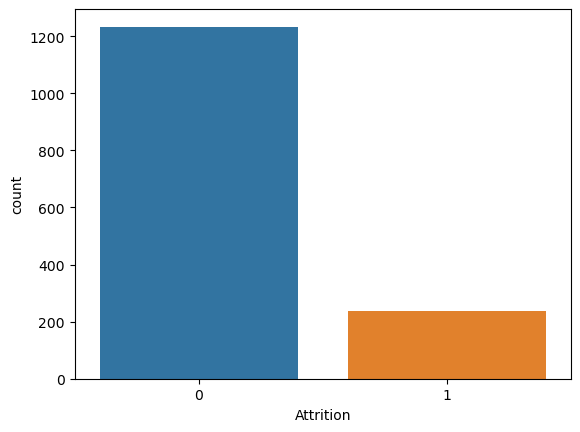

In [92]:
sns.countplot(x=HR_df['Attrition'])
print(HR_df['Attrition'].value_counts())

1    882
0    588
Name: Gender, dtype: int64


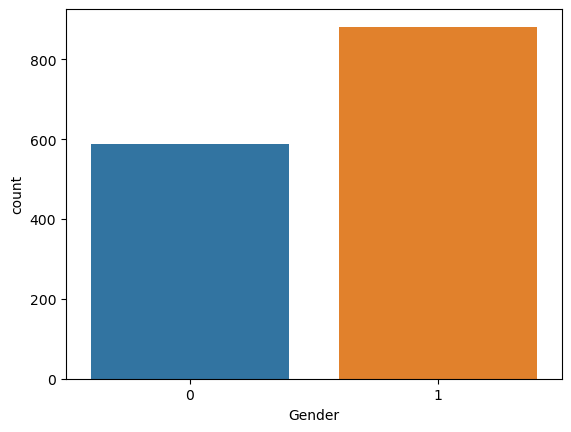

In [93]:
sns.countplot(x=HR_df['Gender'])
print(HR_df['Gender'].value_counts())

1    961
2    446
0     63
Name: Department, dtype: int64


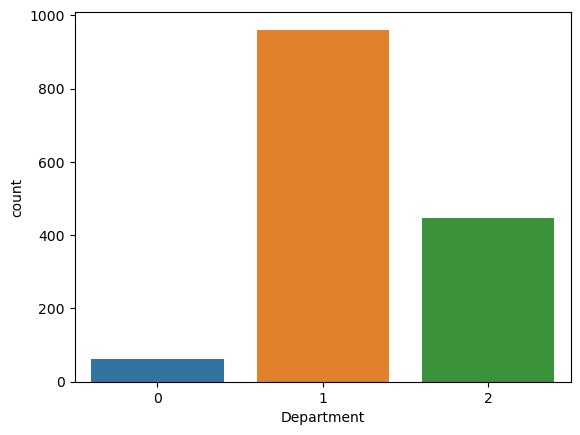

In [94]:
sns.countplot(x=HR_df['Department'])
print(HR_df['Department'].value_counts())

1    606
3    464
2    159
5    132
4     82
0     27
Name: EducationField, dtype: int64


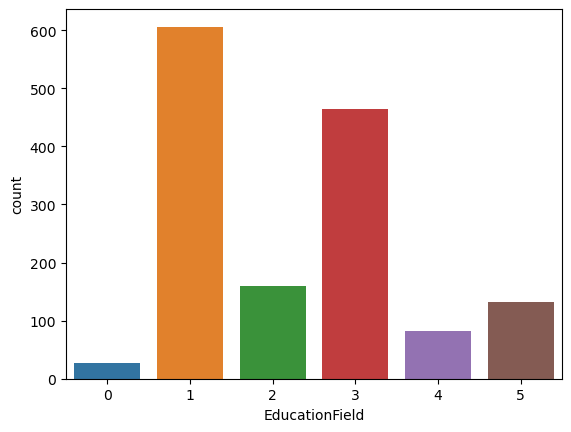

In [95]:
sns.countplot(x=HR_df['EducationField'])
print(HR_df['EducationField'].value_counts())

<Axes: xlabel='Over18', ylabel='count'>

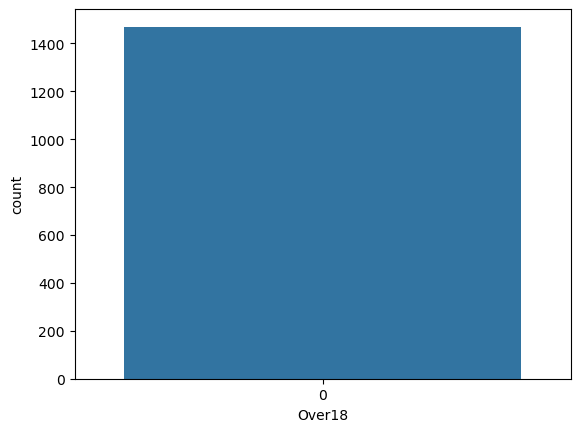

In [96]:
sns.countplot(x=HR_df['Over18'])

<Axes: xlabel='YearsSinceLastPromotion', ylabel='Density'>

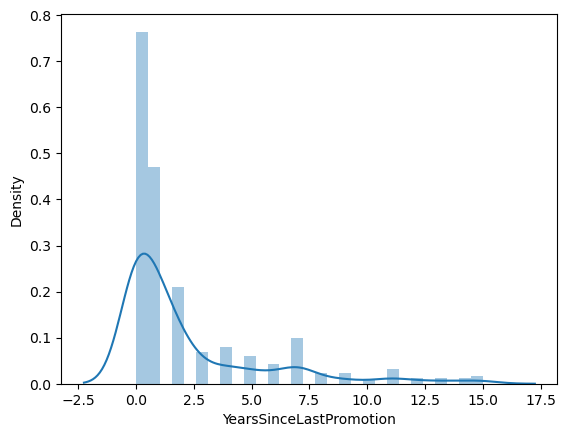

In [97]:
sns.distplot(HR_df['YearsSinceLastPromotion'])

Gender  Attrition
0       0            501
        1             87
1       0            732
        1            150
Name: Attrition, dtype: int64


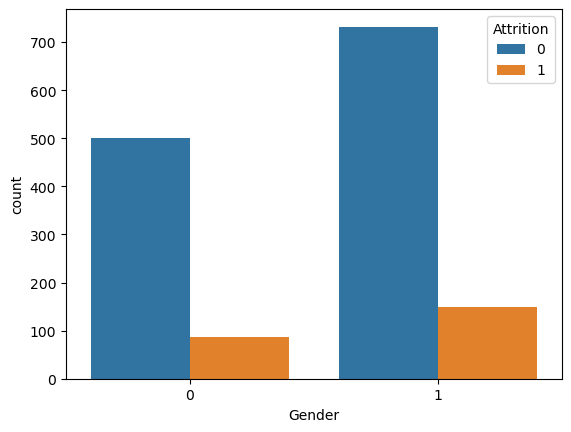

In [98]:
sns.countplot(x='Gender',hue='Attrition',data=HR_df)
print(HR_df.groupby('Gender')['Attrition'].value_counts())

<Axes: xlabel='Department', ylabel='count'>

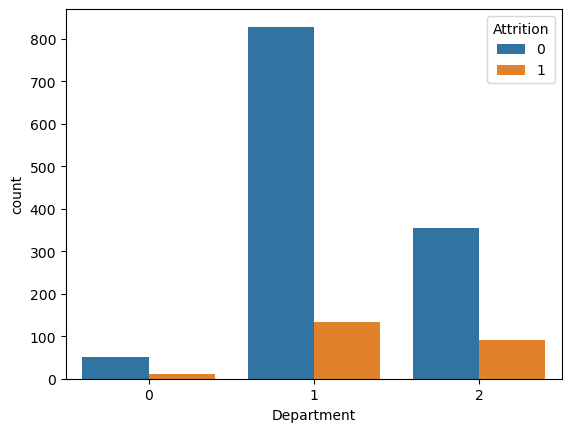

In [99]:
sns.countplot(x='Department',hue='Attrition',data=HR_df)

<Axes: xlabel='BusinessTravel', ylabel='count'>

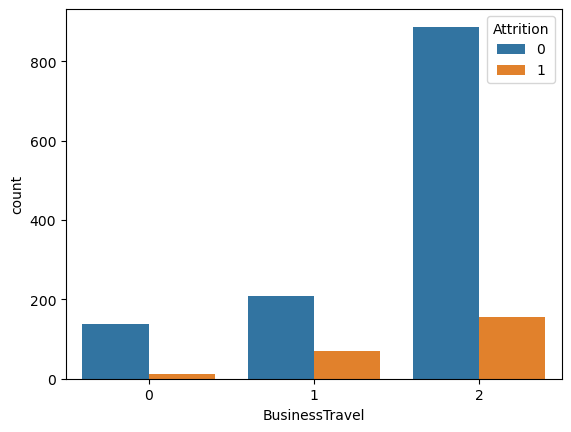

In [100]:
sns.countplot(x='BusinessTravel',hue='Attrition',data=HR_df)

<Axes: xlabel='EducationField', ylabel='count'>

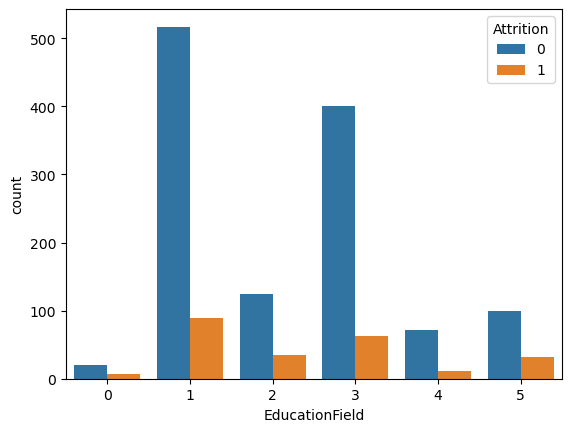

In [101]:
sns.countplot(x='EducationField',hue='Attrition',data=HR_df)

<Axes: xlabel='Attrition', ylabel='Department'>

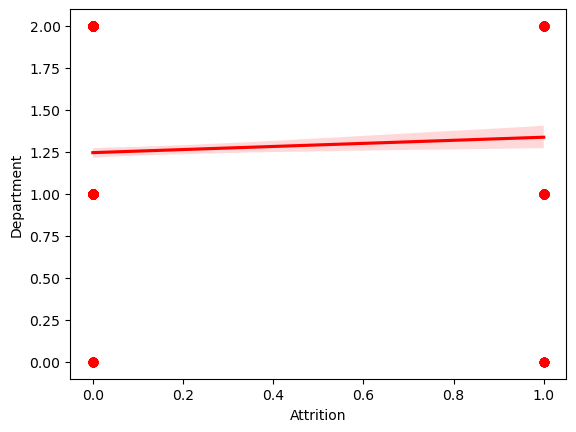

In [102]:
sns.regplot(data=HR_df, x="Attrition", y="Department", color='r')

In [103]:
sns.pairplot(HR_df, hue ='Attrition',palette = 'Dark2')
plt.show()

In [104]:
HR_df.corr()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
Age,1.000000,-0.159205,0.024751,0.010661,-0.031882,-0.001686,0.208034,-0.040873,NaN,-0.010145,...,0.053535,NaN,0.037510,0.680381,-0.019621,-0.021490,0.311309,0.212901,0.216513,0.202089
Attrition,-0.159205,1.000000,0.000074,-0.056652,0.063991,0.077924,-0.031373,0.026846,NaN,-0.010577,...,-0.045872,NaN,-0.137145,-0.171063,-0.059478,-0.063939,-0.134392,-0.160545,-0.033019,-0.156199
BusinessTravel,0.024751,0.000074,1.000000,-0.004086,-0.009044,-0.024469,0.000757,0.023724,NaN,-0.015578,...,-0.035986,NaN,-0.016727,0.034226,0.015240,-0.011256,-0.014575,-0.011497,-0.032591,-0.022636
DailyRate,0.010661,-0.056652,-0.004086,1.000000,0.007109,-0.004985,-0.016806,0.037709,NaN,-0.050990,...,0.007846,NaN,0.042143,0.014515,0.002453,-0.037848,-0.034055,0.009932,-0.033229,-0.026363
Department,-0.031882,0.063991,-0.009044,0.007109,1.000000,0.017225,0.007996,0.013720,NaN,-0.010895,...,-0.022414,NaN,-0.012193,-0.015762,0.036875,0.026383,0.022920,0.056315,0.040061,0.034282
DistanceFromHome,-0.001686,0.077924,-0.024469,-0.004985,0.017225,1.000000,0.021042,0.002013,NaN,0.032916,...,0.006557,NaN,0.044872,0.004628,-0.036942,-0.026556,0.009508,0.018845,0.010029,0.014406
Education,0.208034,-0.031373,0.000757,-0.016806,0.007996,0.021042,1.000000,-0.039592,NaN,0.042070,...,-0.009118,NaN,0.018422,0.148280,-0.025100,0.009819,0.069114,0.060236,0.054254,0.069065
EducationField,-0.040873,0.026846,0.023724,0.037709,0.013720,0.002013,-0.039592,1.000000,NaN,-0.002516,...,-0.004378,NaN,-0.016185,-0.027848,0.049195,0.041191,-0.018692,-0.010506,0.002326,-0.004130
EmployeeCount,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
EmployeeNumber,-0.010145,-0.010577,-0.015578,-0.050990,-0.010895,0.032916,0.042070,-0.002516,NaN,1.000000,...,-0.069861,NaN,0.062227,-0.014365,0.023603,0.010309,-0.011240,-0.008416,-0.009019,-0.009197


In [105]:
df=HR_df.drop(['EmployeeNumber','Age','EmployeeCount','StandardHours'],axis=1)

In [106]:
df

,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EnvironmentSatisfaction,Gender,HourlyRate,...,PerformanceRating,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,1,2,1102,2,1,2,1,2,0,94,...,3,1,0,8,0,1,6,4,0,5
1,0,1,279,1,8,1,1,3,1,61,...,4,4,1,10,3,3,10,7,1,7
2,1,2,1373,1,2,2,4,4,1,92,...,3,2,0,7,3,3,0,0,0,0
3,0,1,1392,1,3,4,1,4,0,56,...,3,3,0,8,3,3,8,7,3,0
4,0,2,591,1,2,1,3,1,1,40,...,3,4,1,6,3,3,2,2,2,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1465,0,1,884,1,23,2,3,3,1,41,...,3,3,1,17,3,3,5,2,0,3
1466,0,2,613,1,6,1,3,4,1,42,...,3,1,1,9,5,3,7,7,1,7
1467,0,2,155,1,4,3,1,2,1,87,...,4,2,1,6,0,3,6,2,0,3
1468,0,1,1023,2,2,3,3,4,1,63,...,3,4,0,17,3,2,9,6,0,8


In [107]:
df.corr()

,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EnvironmentSatisfaction,Gender,HourlyRate,...,PerformanceRating,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
Attrition,1.000000,0.000074,-0.056652,0.063991,0.077924,-0.031373,0.026846,-0.103369,0.029453,-0.006846,...,0.002889,-0.045872,-0.137145,-0.171063,-0.059478,-0.063939,-0.134392,-0.160545,-0.033019,-0.156199
BusinessTravel,0.000074,1.000000,-0.004086,-0.009044,-0.024469,0.000757,0.023724,0.004174,-0.032981,0.026528,...,-0.026341,-0.035986,-0.016727,0.034226,0.015240,-0.011256,-0.014575,-0.011497,-0.032591,-0.022636
DailyRate,-0.056652,-0.004086,1.000000,0.007109,-0.004985,-0.016806,0.037709,0.018355,-0.011716,0.023381,...,0.000473,0.007846,0.042143,0.014515,0.002453,-0.037848,-0.034055,0.009932,-0.033229,-0.026363
Department,0.063991,-0.009044,0.007109,1.000000,0.017225,0.007996,0.013720,-0.019395,-0.041583,-0.004144,...,-0.024604,-0.022414,-0.012193,-0.015762,0.036875,0.026383,0.022920,0.056315,0.040061,0.034282
DistanceFromHome,0.077924,-0.024469,-0.004985,0.017225,1.000000,0.021042,0.002013,-0.016075,-0.001851,0.031131,...,0.027110,0.006557,0.044872,0.004628,-0.036942,-0.026556,0.009508,0.018845,0.010029,0.014406
Education,-0.031373,0.000757,-0.016806,0.007996,0.021042,1.000000,-0.039592,-0.027128,-0.016547,0.016775,...,-0.024539,-0.009118,0.018422,0.148280,-0.025100,0.009819,0.069114,0.060236,0.054254,0.069065
EducationField,0.026846,0.023724,0.037709,0.013720,0.002013,-0.039592,1.000000,0.043163,-0.002504,-0.021941,...,-0.005614,-0.004378,-0.016185,-0.027848,0.049195,0.041191,-0.018692,-0.010506,0.002326,-0.004130
EnvironmentSatisfaction,-0.103369,0.004174,0.018355,-0.019395,-0.016075,-0.027128,0.043163,1.000000,0.000508,-0.049857,...,-0.029548,0.007665,0.003432,-0.002693,-0.019359,0.027627,0.001458,0.018007,0.016194,-0.004999
Gender,0.029453,-0.032981,-0.011716,-0.041583,-0.001851,-0.016547,-0.002504,0.000508,1.000000,-0.000478,...,-0.013859,0.022868,0.012716,-0.046881,-0.038787,-0.002753,-0.029747,-0.041483,-0.026985,-0.030599
HourlyRate,-0.006846,0.026528,0.023381,-0.004144,0.031131,0.016775,-0.021941,-0.049857,-0.000478,1.000000,...,-0.002172,0.001330,0.050263,-0.002334,-0.008548,-0.004607,-0.019582,-0.024106,-0.026716,-0.020123


In [108]:
x = df.drop(['Attrition'], axis =1)
y = df['Attrition']

# Checking the skewness


In [109]:
df.skew().sort_values(ascending=False)

YearsSinceLastPromotion     1.984290
PerformanceRating           1.921883
Attrition                   1.844366
YearsAtCompany              1.764529
MonthlyIncome               1.369817
TotalWorkingYears           1.117172
NumCompaniesWorked          1.026471
JobLevel                    1.025401
StockOptionLevel            0.968980
OverTime                    0.964489
DistanceFromHome            0.958118
YearsInCurrentRole          0.917363
YearsWithCurrManager        0.833451
PercentSalaryHike           0.821128
TrainingTimesLastYear       0.553124
EducationField              0.550371
Department                  0.172231
MonthlyRate                 0.018578
Over18                      0.000000
DailyRate                  -0.003519
HourlyRate                 -0.032311
MaritalStatus              -0.152175
Education                  -0.289681
RelationshipSatisfaction   -0.302828
EnvironmentSatisfaction    -0.321654
JobSatisfaction            -0.329672
JobRole                    -0.357270
G

In [110]:
from sklearn.preprocessing import power_transform
x_new = power_transform(x)

In [111]:
pd.DataFrame(x_new, columns= x.columns).skew().sort_values(ascending=False)

OverTime                    0.964489
YearsSinceLastPromotion     0.212129
PercentSalaryHike           0.116250
JobLevel                    0.103624
StockOptionLevel            0.087019
TrainingTimesLastYear       0.058058
MonthlyIncome               0.032831
NumCompaniesWorked          0.014814
Department                  0.013801
PerformanceRating           0.000000
Over18                      0.000000
DistanceFromHome           -0.007468
EducationField             -0.008386
YearsAtCompany             -0.008683
TotalWorkingYears          -0.010653
WorkLifeBalance            -0.012286
JobInvolvement             -0.020365
YearsInCurrentRole         -0.060849
YearsWithCurrManager       -0.067565
Education                  -0.099881
HourlyRate                 -0.106461
MaritalStatus              -0.156911
MonthlyRate                -0.184087
RelationshipSatisfaction   -0.193634
DailyRate                  -0.196160
EnvironmentSatisfaction    -0.205395
JobSatisfaction            -0.212815
J

In [112]:
x = pd.DataFrame(x_new, columns= x.columns)
x.skew().sort_values(ascending=False)


OverTime                    0.964489
YearsSinceLastPromotion     0.212129
PercentSalaryHike           0.116250
JobLevel                    0.103624
StockOptionLevel            0.087019
TrainingTimesLastYear       0.058058
MonthlyIncome               0.032831
NumCompaniesWorked          0.014814
Department                  0.013801
PerformanceRating           0.000000
Over18                      0.000000
DistanceFromHome           -0.007468
EducationField             -0.008386
YearsAtCompany             -0.008683
TotalWorkingYears          -0.010653
WorkLifeBalance            -0.012286
JobInvolvement             -0.020365
YearsInCurrentRole         -0.060849
YearsWithCurrManager       -0.067565
Education                  -0.099881
HourlyRate                 -0.106461
MaritalStatus              -0.156911
MonthlyRate                -0.184087
RelationshipSatisfaction   -0.193634
DailyRate                  -0.196160
EnvironmentSatisfaction    -0.205395
JobSatisfaction            -0.212815
J

In [113]:
scaler = StandardScaler()
x = pd.DataFrame(scaler.fit_transform(x), columns = x.columns)

In [114]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(x.values,i)
                        for i in range(len(x.columns))]
vif["Features"] = x.columns

vif


,VIF values,Features
0,1.015787,BusinessTravel
1,1.022360,DailyRate
2,2.027015,Department
3,1.013478,DistanceFromHome
4,1.048898,Education
5,1.026237,EducationField
6,1.020478,EnvironmentSatisfaction
7,1.020666,Gender
8,1.021713,HourlyRate
9,1.020086,JobInvolvement


Making the data ready for applying various models but diving it into dependent and independent variable. Spliting it in Test and train.

In [115]:
x_train, x_test, y_train, y_test = train_test_split(x, y,test_size=.30,random_state=39)
print('Training size:',x_train.shape)
print('Training target size:',y_train.shape)
print('Test size:',x_test.shape)
print('Test target size:',y_test.shape)

Training size: (1029, 30)
Training target size: (1029,)
Test size: (441, 30)
Test target size: (441,)


Applying various Regressor Model on the dataset

In [116]:
models = {
    "LogisticRegression": LogisticRegression(),
    "RandomForestClassifier": RandomForestClassifier(),
    "ExtraTreesClassifier": ExtraTreesClassifier(),
    "SVC": SVC(),
    "GradientBoostingClassifier": GradientBoostingClassifier(),
    "AdaBoostClassifier": AdaBoostClassifier(),
    "BaggingClassifier": BaggingClassifier()
}

In [117]:
for model_name, model in models.items():
    model.fit(x_train, y_train)
    y_pred = model.predict(x_test)
    print(f"{model_name} accuracy: {accuracy_score(y_test, y_pred)}")
    print(confusion_matrix(y_test, y_pred))
    print(classification_report(y_test, y_pred))

LogisticRegression accuracy: 0.8775510204081632
[[363   8]
 [ 46  24]]
              precision    recall  f1-score   support

           0       0.89      0.98      0.93       371
           1       0.75      0.34      0.47        70

    accuracy                           0.88       441
   macro avg       0.82      0.66      0.70       441
weighted avg       0.87      0.88      0.86       441

RandomForestClassifier accuracy: 0.8662131519274376
[[369   2]
 [ 57  13]]
              precision    recall  f1-score   support

           0       0.87      0.99      0.93       371
           1       0.87      0.19      0.31        70

    accuracy                           0.87       441
   macro avg       0.87      0.59      0.62       441
weighted avg       0.87      0.87      0.83       441

ExtraTreesClassifier accuracy: 0.8684807256235828
[[371   0]
 [ 58  12]]
              precision    recall  f1-score   support

           0       0.86      1.00      0.93       371
           1      

In [118]:
for model_name, model in models.items():
    cv_scores = cross_val_score(model, x, y, cv=5)
    print(f"{model_name} CV mean accuracy: {cv_scores.mean():.2f} ± {cv_scores.std():.2f}")


LogisticRegression CV mean accuracy: 0.87 ± 0.01
RandomForestClassifier CV mean accuracy: 0.86 ± 0.01
ExtraTreesClassifier CV mean accuracy: 0.86 ± 0.01
SVC CV mean accuracy: 0.86 ± 0.01
GradientBoostingClassifier CV mean accuracy: 0.86 ± 0.01
AdaBoostClassifier CV mean accuracy: 0.87 ± 0.02
BaggingClassifier CV mean accuracy: 0.85 ± 0.01


In [119]:
LR=LogisticRegression()

In [120]:
LR.fit(x_train,y_train)

LogisticRegression()

In [121]:
parameters={'C': [0.001, 0.01, 0.1, 1, 10, 100, 1000]}
    

In [122]:
grid_GBC = GridSearchCV(LR, parameters,cv=2,n_jobs=-1)
grid_GBC.fit(x_train, y_train)

GridSearchCV(cv=2, estimator=LogisticRegression(), n_jobs=-1,
             param_grid={'C': [0.001, 0.01, 0.1, 1, 10, 100, 1000]})

In [123]:
filename="HR_Model.pkl"
with open(filename, 'wb') as file:
    pickle.dump(LR, file)
with open(filename, 'rb') as file:
    Final_Model = pickle.load(file)
result = Final_Model.score(x_test, y_test)
print(result)

0.8775510204081632


# FINAL SUMMARY
Every year a lot of companies hire a number of employees. The companies invest time and money in training those employees, not just this but there are training programs within the companies for their existing employees as well. The aim of these programs is to increase the effectiveness of their employees. But where HR Analytics fit in this? and is it just about improving the performance of employees. The approach for this project is  exploratory data analysis and predictive modeling on the Base ball dataset. In this project following libaries are used for performing various functions on the data set:- Numpy, Pandas, Sci-kit learn,matplotlib.pyplot and seaborn.

ABOUT THE DATASET
                      
 1   Attrition                 
 2   BusinessTravel            
 3   DailyRate                  
 4   Department                
 5   DistanceFromHome          
 6   Education                 
 7   EducationField            
 8   EmployeeCount              
 9   EmployeeNumber            
 10  EnvironmentSatisfaction   
 11  Gender  
 12  HourlyRate
 13  JobInvolvement            
 14  JobLevel 
 15  JobRole
 16  JobSatisfaction           
 17  MaritalStatus             
 18  MonthlyIncome             
 19  MonthlyRate                
 20  NumCompaniesWorked         
 21  Over18                   
 23  PercentSalaryHike         
 24  PerformanceRating         
 25  RelationshipSatisfaction  
 26  StandardHours              
 27  StockOptionLevel          
 28  TotalWorkingYears          
 29  TrainingTimesLastYear     
 30  WorkLifeBalance           
 31  YearsAtCompany            
 32  YearsInCurrentRole         
 33  YearsSinceLastPromotion   
 34  YearsWithCurrManager 
 35  Age

STEPS IN INVLOVED IN THE PROCESS

Checked to number of rows n columns present in dataset. Checking data type(as all the columns are present in both numerical and categorical form so, converted the data in numerical data). Check for the null values in dataset and used heat map to show the same. Performed data description in order to check mean,medain etc so, that it will be easy to understand how is skeweed. Applied different graphs(bar,his,scatter) on the data to understand in more better way(visual form) Check the outliers in the data and removed the same by using Zscore test. Checked the skewness of data and removed it by using cuberoot and log transforms. Checked the coorelation between independent variable and dependent variable. Used train test split method to divide the data(test size is 30%). Applied various Classification model to check which works best on dataset and also applied cross value method to get more acurracy. CONCLUSION Logistic Regression model works best on dataset with 87.7% accuracy.
